## Sample code to preprocess FEMA images, especially ones of Wild Fire

## 1) DeHaze

For de-hazing the image, we plan to use the seminal paper by He et al. (2009). This paper determines, on a per pixel basis, the transmissivity and the atmospheric light, and uses this information to de-haze the scene. Below is one such example of this. The left hand image is the original image from the dataset, and the one on the right is the de-hazed image.

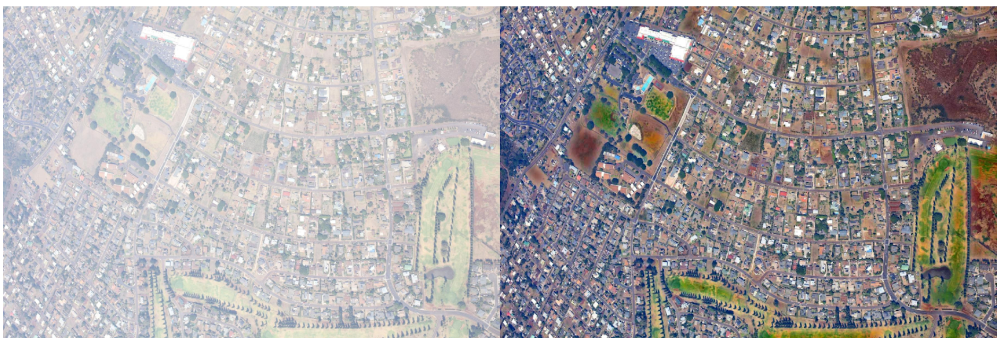

He, K., Sun, J., & Tang, X. (2009, June 1). Single image haze removal using dark channel prior.
IEEE Xplore. https://doi.org/10.1109/CVPR.2009.5206515

Required Python packages

pip install numpy

pip install opencv-python

pip install opencv-contrib-python

pip install matplotlib

In [ ]:
# start by emptying the results folder
!rm -rf results

: 

In [1]:
import cv2
import numpy as np

"""
Perform haze removal on an input image using dark channel prior and guided filter.

Parameters:
image (numpy.ndarray): Input image in BGR format.
omega (float, optional): Weight parameter for the transmission map. Default is 0.95.
radius (int, optional): Radius for the erosion operation and guided filter. Default is 15.
epsilon (float, optional): Regularization parameter for the guided filter. Default is 0.001.

Returns:
numpy.ndarray: Haze-free image in BGR format.
"""
def haze_removal(image, omega=0.95, radius=15, epsilon=0.001):
    # Step 1: Convert the image to grayscale
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

    # Step 2: Estimate the atmospheric light
    atmospheric_light = np.max(gray)

    # Step 3: Calculate the transmission map using dark channel prior
    dark_channel = cv2.erode(gray, np.ones((radius, radius), np.uint8))
    transmission = 1 - omega * dark_channel / atmospheric_light
    transmission.astype(np.float32)
    
    # Step 4: Refine the transmission map using guided filter
    guided_filter = cv2.ximgproc.createGuidedFilter(gray, radius, epsilon)
    refined_transmission = guided_filter.filter(transmission)

    # Step 5: Remove the haze using the transmission map and atmospheric light
    haze_free = np.zeros_like(image, dtype=np.float64)
    for i in range(3):
        haze_free[:, :, i] = (image[:, :, i] - atmospheric_light) / refined_transmission + atmospheric_light

    haze_free = np.clip(haze_free, 0, 255).astype(np.uint8)

    return haze_free

### Sample Code to use Haze Removal

In [28]:
import os

# Path to the images folder
folder_path = "images"

# Get the list of image files in the folder
image_files = [f for f in os.listdir(folder_path) if os.path.isfile(os.path.join(folder_path, f))]

# Apply haze removal to each image
for file in image_files:
    # Read the image
    image_path = os.path.join(folder_path, file)
    image = cv2.imread(image_path)
    image = image.astype(np.float32)

    # Apply haze removal
    haze_free_image = haze_removal(image, omega=0.9, radius=20, epsilon=0.0001)

    # Combine image and haze_free_image
    combined_image = np.concatenate((image, haze_free_image), axis=1)

    # Save the combined image
    combined_image_path = os.path.join(folder_path + "/../results/", "combined_dh_" + file)
    dh_image_path = os.path.join(folder_path + "/../results/", "dh_" + file)

    cv2.imwrite(combined_image_path, combined_image)
    cv2.imwrite(dh_image_path, haze_free_image)

    # Display the original and haze-free images
    # cv2.imshow("Original Image", image)
    # cv2.imshow("Haze-Free Image", haze_free_image)
    
    # cv2.waitKey(0)

# Close all windows
# cv2.destroyAllWindows()

### Display the combined images

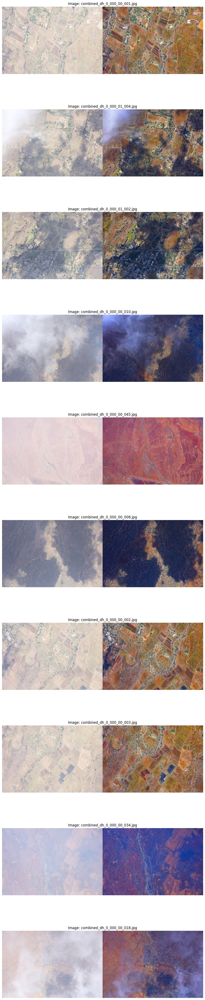

In [29]:
import glob

import matplotlib.pyplot as plt

# Get the list of combined image files in the folder
combined_image_files = glob.glob(os.path.join(folder_path + "/../results/", "combined_dh_*.jpg"))

# Number of images
num_images = len(combined_image_files)

# Create a figure with 1 column and multiple rows
fig, axes = plt.subplots(num_images, 1, figsize=(10, 5 * num_images))

# Display each image in the grid
for i, file in enumerate(combined_image_files):
    image = cv2.imread(file)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)  # Convert BGR to RGB for displaying with matplotlib
    axes[i].imshow(image)
    axes[i].axis('off')
    axes[i].set_title(f"Image: {os.path.basename(file)}")

plt.tight_layout()
plt.show()

## 2) Contrast Enhancement

For the issue related to poor contrast, we plan to level the work of Zuiderveld (1994). The technique is Contrast Limited Adaptive Histogram Equalization (CLAHE), and it carries out localized, adaptive contrast adjustment, which is also in sync with its neighboring pixels. The result of CLAHE on an image from the dataset (on the left) can be seen in the resultant image on the right.

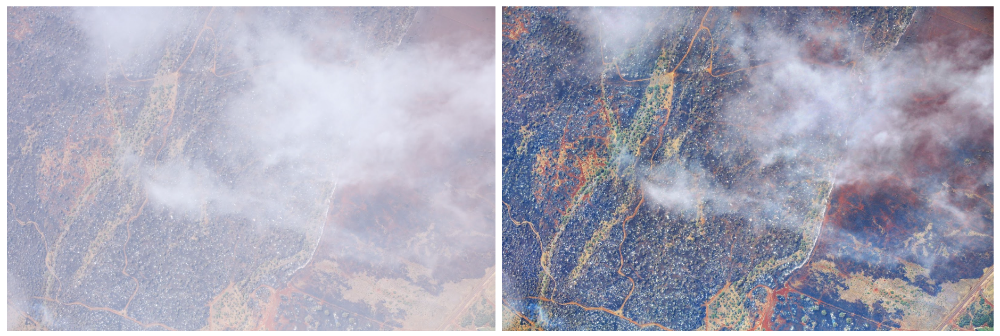

Zuiderveld, K. (1994). Contrast Limited Adaptive Histogram Equalization. Graphics Gems, 474–485. https://doi.org/10.1016/b978-0-12-336156-1.50061-6 

In [32]:
"""
Perform contrast enhancement on an input image using CLAHE.

Parameters:
image (numpy.ndarray): Input image in BGR format.
clip_limit (float, optional): Threshold for contrast limiting. Default is 2.0.
tile_grid_size (tuple, optional): Size of grid for histogram equalization. Default is (8, 8).

Returns:
numpy.ndarray: Contrast-enhanced image in BGR format.
"""
def contrast_enhancement(image, clip_limit=2.0, tile_grid_size=(8, 8)):

    # Convert the image to LAB color space
    lab = cv2.cvtColor(image, cv2.COLOR_BGR2LAB)

    # Split the LAB image into L, A, and B channels
    l, a, b = cv2.split(lab)
    
    # Apply CLAHE to the L channel
    clahe = cv2.createCLAHE(clipLimit=clip_limit, tileGridSize=tile_grid_size)
    cl = clahe.apply(l)
    
    # Merge the CLAHE enhanced L channel with the A and B channels
    limg = cv2.merge((cl, a, b))

    # Convert the LAB image back to BGR color space
    enhanced_image = cv2.cvtColor(limg, cv2.COLOR_LAB2BGR)

    return enhanced_image

In [34]:
import os

# Path to the images folder
folder_path = "images"

# Get the list of image files in the folder
image_files = [f for f in os.listdir(folder_path) if os.path.isfile(os.path.join(folder_path, f))]

# Apply haze removal to each image
for file in image_files:
    # Read the image
    image_path = os.path.join(folder_path, file)
    image = cv2.imread(image_path)

    # Apply contrast enhancement
    haze_free_image = contrast_enhancement(image, clip_limit=1.5, tile_grid_size=(8, 8))
    # Combine image and contrast enhanced image
    combined_image = np.concatenate((image, haze_free_image), axis=1)

    # Save the combined image
    combined_image_path = os.path.join(folder_path + "/../results/", "combined_clahe_" + file)
    dh_image_path = os.path.join(folder_path + "/../results/", "clahe_" + file)

    cv2.imwrite(combined_image_path, combined_image)
    cv2.imwrite(dh_image_path, haze_free_image)


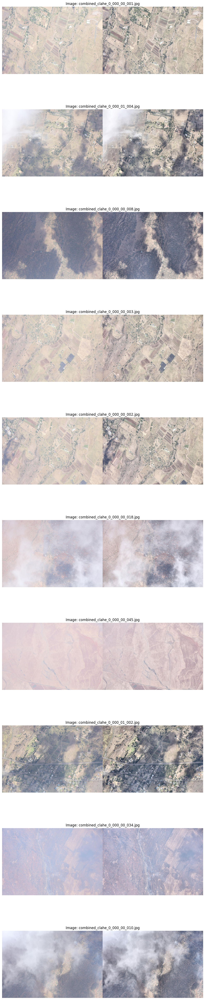

In [35]:
import glob

import matplotlib.pyplot as plt

# Get the list of combined image files in the folder
combined_image_files = glob.glob(os.path.join(folder_path + "/../results/", "combined_clahe_*.jpg"))

# Number of images
num_images = len(combined_image_files)

# Create a figure with 1 column and multiple rows
fig, axes = plt.subplots(num_images, 1, figsize=(10, 5 * num_images))

# Display each image in the grid
for i, file in enumerate(combined_image_files):
    image = cv2.imread(file)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)  # Convert BGR to RGB for displaying with matplotlib
    axes[i].imshow(image)
    axes[i].axis('off')
    axes[i].set_title(f"Image: {os.path.basename(file)}")

plt.tight_layout()
plt.show()

Both these techniques have certain tunable parameters, and we plan to use them as hyperparameters in the training and validation experiments to determine the benefits they bring. We also plan to do ablation studies by eliminating either one or both of these processing steps to judge the benefits they provide individually and when used together.

*Note*: GitHub CoPilot has been used to generate comments, and test code